In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import umap
import torch
import torch.nn as nn
import torch.nn.functional as F

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
import os
os.chdir('../IConNet/')
os.getcwd()

'/home/linh/projects/IConNet'

In [5]:
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"
import gc
import sys
import numpy as np
from tqdm import tqdm

In [6]:
from einops import rearrange, reduce, repeat

In [7]:
dataset_name = 'ravdess'
experiment_prefix = "scb10"
log_dir = f'../{experiment_prefix}_models/{dataset_name}/'
data_dir = "../data/data_preprocessed/"

In [8]:
def generate_positional_encoding_with_stride(seq_len, d_model, stride=128):
    """
    Arguments:
        seq_len: max number of tokens for a sequence
        d_model: length of vector position
    Return:
        pe: (seq_len, d_model) sinusoid position encoding matrix [Vaswani et al,.]
        .. pe[pos_id, 2i] =  sin((pos_id*stride)/10000^(2i / d_model)) 
        .. pe[pos_id, 2i+1] =  cos((pos_id*stride)/10000^(2i / d_model)) 
    """
    t = 1/10000**(2/d_model*torch.arange(d_model//2))[None, :]
    pos = torch.arange(seq_len)[:, None]
    pos = stride*pos
    pe = rearrange(
        torch.stack([torch.sin(pos*t), torch.cos(pos*t)], dim=1), 
        'p c d -> p (d c)')
    return pe

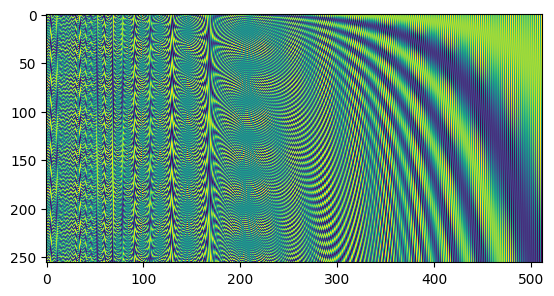

In [9]:
pe = generate_positional_encoding_with_stride(256, 512)
plt.imshow(pe)
plt.show()

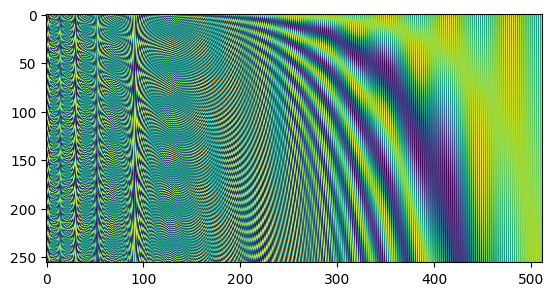

In [10]:
pe = generate_positional_encoding_with_stride(256, 512, stride=32)
plt.imshow(pe)
plt.show()

In [11]:
sr = 16000
batch_size = 4
in_channels = 1
kernel_size = 512
stride = 125
embedding_dim = 512
num_embeddings = 384
cls_dim = 500
downsampling = 8
learning_rate = 1e-3
max_num_tokens = 2048
num_classes = 4
commitment_cost = 0.25

In [12]:
from IConNet.acov.audio_vqmix import AudioVQMixClsLoss
from IConNet.trainer.train_torch import get_dataloader
from IConNet.trainer.train_torch import Trainer_SCB10 as Trainer
from IConNet.acov.model import SCB10 as SCB
from omegaconf import OmegaConf as ocf

n_epoch = 4

loss_ratio=AudioVQMixClsLoss(
    wave_perplexity=0, wave_loss_vq=1, 
    mfcc_perplexity=0, mfcc_loss_vq=1, loss_cls=1)

trainer = Trainer(batch_size=batch_size, log_dir=log_dir, 
                  experiment_prefix=experiment_prefix, device=device,
                 accumulate_grad_batches=4)

dataset_config_path = f'config/dataset/{dataset_name}.yaml'
dataset_config = ocf.load(dataset_config_path)
print(dataset_config)
train_loader, test_loader, batch_size = get_dataloader(
    dataset_config, data_dir, batch_size=batch_size)
print(batch_size)

trainer.prepare(train_loader=train_loader, 
                test_loader=test_loader, 
                batch_size=batch_size,
               loss_ratio=loss_ratio)

{'name': 'ravdess', 'dataset_class': 'WaveformDataset', 'root': 'ravdess/', 'audio_dir': 'full_release/', 'feature_dir': 'preprocessing/', 'label_name': 'label_emotion_key', 'feature_name': 'audio16k', 'num_classes': 8, 'label_values': ['neu', 'cal', 'hap', 'sad', 'ang', 'fea', 'dis', 'sur'], 'classnames': ['neu', 'cal', 'hap', 'sad', 'ang', 'fea', 'dis', 'sur'], 'target_labels': ['ang', 'neu', 'sad', 'hap']}
4


In [13]:
model = SCB(
    in_channels=in_channels,    
    num_embeddings=num_embeddings, 
    embedding_dim=embedding_dim, 
    num_classes=num_classes, 
    cls_dim=cls_dim,
    sample_rate=sr,
    commitment_cost=commitment_cost,
    distance_type='euclidean'
)

In [14]:
trainer.setup(model=model, lr=1e-3)

In [15]:
trainer.fit(n_epoch=n_epoch)

  9%|███▎                               | 0.3798882681564243/4 [00:23<09:31, 157.95s/it]

Epoch: 1	Loss: 1.508 [wave_perplexity=1.079, wave_loss_vq=0.002, mfcc_perplexity=1.073, mfcc_loss_vq=0.002, loss_cls=1.505]	Val_acc: 7/27 (25.93%)

Saved new best model: ../scb10_models/ravdess/model.epoch=1.step=51.loss=1.508.val_acc=0.259.pt


 25%|█████████▎                           | 1.000000000000004/4 [00:53<02:19, 46.38s/it]

Correct: 38/135 (0.2815)
tensor([[38,  0,  0,  0],
        [19,  0,  0,  0],
        [39,  0,  0,  0],
        [39,  0,  0,  0]], device='cuda:0')


 34%|████████████▍                       | 1.379888268156432/4 [01:13<06:44, 154.28s/it]

Epoch: 2	Loss: 1.438 [wave_perplexity=1.030, wave_loss_vq=0.001, mfcc_perplexity=1.027, mfcc_loss_vq=0.001, loss_cls=1.437]	Val_acc: 7/27 (25.93%)



 50%|██████████████████▌                  | 2.000000000000013/4 [01:42<01:27, 43.84s/it]

Correct: 38/135 (0.2815)
tensor([[38,  0,  0,  0],
        [19,  0,  0,  0],
        [39,  0,  0,  0],
        [39,  0,  0,  0]], device='cuda:0')


 59%|█████████████████████▍              | 2.379888268156441/4 [02:03<04:12, 156.12s/it]

Epoch: 3	Loss: 1.302 [wave_perplexity=1.000, wave_loss_vq=0.000, mfcc_perplexity=1.000, mfcc_loss_vq=0.000, loss_cls=1.302]	Val_acc: 9/27 (33.33%)

Saved new best model: ../scb10_models/ravdess/model.epoch=3.step=251.loss=1.302.val_acc=0.333.pt


 75%|███████████████████████████         | 3.0000000000000218/4 [02:31<00:44, 44.51s/it]

Correct: 38/135 (0.2815)
tensor([[38,  0,  0,  0],
        [19,  0,  0,  0],
        [39,  0,  0,  0],
        [39,  0,  0,  0]], device='cuda:0')


 84%|█████████████████████████████▌     | 3.3798882681564497/4 [02:51<01:35, 153.76s/it]

Epoch: 4	Loss: 1.222 [wave_perplexity=1.021, wave_loss_vq=0.000, mfcc_perplexity=1.021, mfcc_loss_vq=0.000, loss_cls=1.222]	Val_acc: 7/27 (25.93%)



100%|███████████████████████████████████▉| 3.9944134078212596/4 [03:19<00:00, 43.59s/it]/opt/anaconda3/envs/audio/lib/python3.9/site-packages/tqdm/std.py:639: TqdmWarning: clamping frac to range [0, 1]
  full_bar = Bar(frac,
100%|██████████████████████████████████████| 4.00000000000003/4 [03:20<00:00, 50.07s/it]

Correct: 38/135 (0.2815)
tensor([[38,  0,  0,  0],
        [19,  0,  0,  0],
        [39,  0,  0,  0],
        [39,  0,  0,  0]], device='cuda:0')


In [16]:
trainer.fit(n_epoch=16)

  2%|▊                                 | 0.3798882681564243/16 [00:20<40:13, 154.54s/it]

Epoch: 5	Loss: 1.442 [wave_perplexity=1.359, wave_loss_vq=0.007, mfcc_perplexity=1.290, mfcc_loss_vq=0.007, loss_cls=1.427]	Val_acc: 6/27 (22.22%)



  6%|██▎                                 | 1.000000000000004/16 [00:48<11:08, 44.58s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


  9%|███                                | 1.379888268156432/16 [01:08<37:26, 153.64s/it]

Epoch: 6	Loss: 1.297 [wave_perplexity=1.428, wave_loss_vq=0.005, mfcc_perplexity=1.341, mfcc_loss_vq=0.006, loss_cls=1.286]	Val_acc: 9/27 (33.33%)



 13%|████▌                               | 2.000000000000013/16 [01:36<10:25, 44.71s/it]

Correct: 38/135 (0.2815)
tensor([[38,  0,  0,  0],
        [19,  0,  0,  0],
        [39,  0,  0,  0],
        [39,  0,  0,  0]], device='cuda:0')


 15%|█████▏                             | 2.379888268156441/16 [01:56<35:04, 154.53s/it]

Epoch: 7	Loss: 1.478 [wave_perplexity=1.380, wave_loss_vq=0.006, mfcc_perplexity=1.315, mfcc_loss_vq=0.008, loss_cls=1.464]	Val_acc: 7/27 (25.93%)



 19%|██████▌                            | 3.0000000000000218/16 [02:25<09:27, 43.66s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 21%|███████▏                          | 3.3798882681564497/16 [02:45<32:26, 154.27s/it]

Epoch: 8	Loss: 1.287 [wave_perplexity=1.271, wave_loss_vq=0.003, mfcc_perplexity=1.245, mfcc_loss_vq=0.003, loss_cls=1.280]	Val_acc: 6/27 (22.22%)



 25%|█████████▎                           | 4.00000000000003/16 [03:13<08:50, 44.23s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 27%|█████████▌                         | 4.379888268156458/16 [03:34<29:47, 153.84s/it]

Epoch: 9	Loss: 1.430 [wave_perplexity=1.025, wave_loss_vq=0.001, mfcc_perplexity=1.022, mfcc_loss_vq=0.000, loss_cls=1.429]	Val_acc: 9/27 (33.33%)



 31%|███████████▎                        | 5.000000000000039/16 [04:02<08:11, 44.71s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0,  0, 38],
        [ 0,  0,  0, 19],
        [ 0,  0,  0, 39],
        [ 0,  0,  0, 39]], device='cuda:0')


 34%|███████████▊                       | 5.379888268156467/16 [04:22<27:25, 154.94s/it]

Epoch: 10	Loss: 1.274 [wave_perplexity=1.148, wave_loss_vq=0.002, mfcc_perplexity=1.131, mfcc_loss_vq=0.002, loss_cls=1.270]	Val_acc: 9/27 (33.33%)



 38%|█████████████▌                      | 6.000000000000048/16 [04:51<07:17, 43.79s/it]

Correct: 38/135 (0.2815)
tensor([[38,  0,  0,  0],
        [19,  0,  0,  0],
        [39,  0,  0,  0],
        [39,  0,  0,  0]], device='cuda:0')


 40%|█████████████▉                     | 6.379888268156476/16 [05:11<25:01, 156.10s/it]

Epoch: 11	Loss: 1.276 [wave_perplexity=1.088, wave_loss_vq=0.001, mfcc_perplexity=1.080, mfcc_loss_vq=0.001, loss_cls=1.274]	Val_acc: 6/27 (22.22%)



 44%|███████████████▊                    | 7.000000000000057/16 [05:39<06:30, 43.43s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0,  0, 38],
        [ 0,  0,  0, 19],
        [ 0,  0,  0, 39],
        [ 0,  0,  0, 39]], device='cuda:0')


 46%|████████████████▏                  | 7.379888268156485/16 [05:59<22:15, 154.93s/it]

Epoch: 12	Loss: 1.232 [wave_perplexity=1.484, wave_loss_vq=0.005, mfcc_perplexity=1.431, mfcc_loss_vq=0.005, loss_cls=1.222]	Val_acc: 9/27 (33.33%)



 50%|██████████████████                  | 8.000000000000066/16 [06:28<05:49, 43.64s/it]

Correct: 38/135 (0.2815)
tensor([[38,  0,  0,  0],
        [19,  0,  0,  0],
        [39,  0,  0,  0],
        [39,  0,  0,  0]], device='cuda:0')


 52%|██████████████████▎                | 8.379888268156494/16 [06:48<19:38, 154.63s/it]

Epoch: 13	Loss: 1.405 [wave_perplexity=1.171, wave_loss_vq=0.002, mfcc_perplexity=1.158, mfcc_loss_vq=0.002, loss_cls=1.401]	Val_acc: 6/27 (22.22%)



 56%|████████████████████▎               | 9.000000000000075/16 [07:16<05:06, 43.73s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 59%|████████████████████▌              | 9.379888268156503/16 [07:37<17:25, 157.92s/it]

Epoch: 14	Loss: 1.265 [wave_perplexity=1.170, wave_loss_vq=0.002, mfcc_perplexity=1.146, mfcc_loss_vq=0.002, loss_cls=1.261]	Val_acc: 7/27 (25.93%)



 63%|█████████████████████▉             | 10.000000000000083/16 [08:05<04:26, 44.38s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 65%|██████████████████████            | 10.379888268156511/16 [08:25<14:26, 154.23s/it]

Epoch: 15	Loss: 1.438 [wave_perplexity=1.069, wave_loss_vq=0.001, mfcc_perplexity=1.063, mfcc_loss_vq=0.001, loss_cls=1.436]	Val_acc: 9/27 (33.33%)



 69%|████████████████████████           | 11.000000000000092/16 [08:54<03:37, 43.41s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 71%|████████████████████████▉          | 11.37988826815652/16 [09:14<12:06, 157.23s/it]

Epoch: 16	Loss: 1.622 [wave_perplexity=1.609, wave_loss_vq=0.006, mfcc_perplexity=1.507, mfcc_loss_vq=0.006, loss_cls=1.610]	Val_acc: 6/27 (22.22%)



 75%|██████████████████████████▎        | 12.000000000000101/16 [09:42<02:54, 43.53s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0,  0, 38],
        [ 0,  0,  0, 19],
        [ 0,  0,  0, 39],
        [ 0,  0,  0, 39]], device='cuda:0')


 77%|███████████████████████████        | 12.37988826815653/16 [10:02<09:21, 155.11s/it]

Epoch: 17	Loss: 1.267 [wave_perplexity=1.115, wave_loss_vq=0.001, mfcc_perplexity=1.099, mfcc_loss_vq=0.001, loss_cls=1.265]	Val_acc: 9/27 (33.33%)



 81%|█████████████████████████████▎      | 13.00000000000011/16 [10:31<02:13, 44.36s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0,  0, 38],
        [ 0,  0,  0, 19],
        [ 0,  0,  0, 39],
        [ 0,  0,  0, 39]], device='cuda:0')


 84%|████████████████████████████▍     | 13.379888268156538/16 [10:51<06:46, 155.09s/it]

Epoch: 18	Loss: 1.547 [wave_perplexity=1.035, wave_loss_vq=0.000, mfcc_perplexity=1.037, mfcc_loss_vq=0.000, loss_cls=1.546]	Val_acc: 9/27 (33.33%)



 88%|██████████████████████████████▋    | 14.000000000000119/16 [11:19<01:27, 43.54s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 90%|██████████████████████████████▌   | 14.379888268156547/16 [11:39<04:13, 156.46s/it]

Epoch: 19	Loss: 1.451 [wave_perplexity=1.000, wave_loss_vq=0.000, mfcc_perplexity=1.000, mfcc_loss_vq=0.000, loss_cls=1.451]	Val_acc: 6/27 (22.22%)



 94%|████████████████████████████████▊  | 15.000000000000128/16 [12:08<00:43, 43.56s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 96%|████████████████████████████████▋ | 15.379888268156556/16 [12:28<01:36, 155.45s/it]

Epoch: 20	Loss: 1.585 [wave_perplexity=1.167, wave_loss_vq=0.001, mfcc_perplexity=1.147, mfcc_loss_vq=0.001, loss_cls=1.582]	Val_acc: 9/27 (33.33%)



100%|███████████████████████████████████| 16.000000000000135/16 [12:56<00:00, 48.54s/it]

Correct: 38/135 (0.2815)
tensor([[38,  0,  0,  0],
        [19,  0,  0,  0],
        [39,  0,  0,  0],
        [39,  0,  0,  0]], device='cuda:0')


In [20]:
model_nomask = SCB(
    in_channels=in_channels,    
    num_embeddings=num_embeddings, 
    embedding_dim=embedding_dim, 
    num_classes=num_classes, 
    cls_dim=cls_dim,
    sample_rate=sr,
    commitment_cost=commitment_cost,
    distance_type='euclidean'
)

In [21]:
trainer.setup(model=model_nomask, lr=1e-3)

In [22]:
trainer.fit(n_epoch=n_epoch)

  9%|███▎                               | 0.3798882681564243/4 [00:20<07:57, 131.88s/it]

Epoch: 1	Loss: 1.625 [wave_perplexity=78.931, wave_loss_vq=0.145, mfcc_perplexity=20.452, mfcc_loss_vq=0.159, loss_cls=1.321]	Val_acc: 5/27 (18.52%)

Saved new best model: ../scb10_models/ravdess/model.epoch=1.step=51.loss=1.625.val_acc=0.185.pt


 25%|█████████▎                           | 1.000000000000004/4 [00:50<02:27, 49.33s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 34%|████████████▍                       | 1.379888268156432/4 [01:11<05:45, 131.92s/it]

Epoch: 2	Loss: 1.562 [wave_perplexity=71.630, wave_loss_vq=0.111, mfcc_perplexity=18.555, mfcc_loss_vq=0.142, loss_cls=1.309]	Val_acc: 9/27 (33.33%)

Saved new best model: ../scb10_models/ravdess/model.epoch=2.step=151.loss=1.562.val_acc=0.333.pt


 50%|██████████████████▌                  | 2.000000000000013/4 [01:41<01:32, 46.27s/it]

Correct: 38/135 (0.2815)
tensor([[38,  0,  0,  0],
        [19,  0,  0,  0],
        [39,  0,  0,  0],
        [39,  0,  0,  0]], device='cuda:0')


 59%|█████████████████████▍              | 2.379888268156441/4 [02:02<03:31, 130.83s/it]

Epoch: 3	Loss: 1.541 [wave_perplexity=131.873, wave_loss_vq=0.098, mfcc_perplexity=27.395, mfcc_loss_vq=0.115, loss_cls=1.328]	Val_acc: 9/27 (33.33%)



 75%|███████████████████████████         | 3.0000000000000218/4 [02:32<00:45, 45.92s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0,  0, 38],
        [ 0,  0,  0, 19],
        [ 0,  0,  0, 39],
        [ 0,  0,  0, 39]], device='cuda:0')


 84%|█████████████████████████████▌     | 3.3798882681564497/4 [02:53<01:21, 131.64s/it]

Epoch: 4	Loss: 1.366 [wave_perplexity=111.358, wave_loss_vq=0.091, mfcc_perplexity=26.377, mfcc_loss_vq=0.098, loss_cls=1.178]	Val_acc: 7/27 (25.93%)



100%|██████████████████████████████████████| 4.00000000000003/4 [03:23<00:00, 50.80s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


In [26]:
model3 = SCB(
    in_channels=in_channels,    
    kernel_size = 256,
    stride = 125,
    num_embeddings=num_embeddings, 
    embedding_dim=embedding_dim, 
    num_classes=num_classes, 
    cls_dim=cls_dim,
    sample_rate=sr,
    commitment_cost=commitment_cost,
    distance_type='euclidean'
)

In [27]:
trainer.setup(model=model3, lr=1e-3)

In [28]:
trainer.fit(n_epoch=10)

  4%|█▎                                | 0.3798882681564243/10 [00:23<25:38, 159.92s/it]

Epoch: 1	Loss: 1.357 [wave_perplexity=1.181, wave_loss_vq=0.005, mfcc_perplexity=1.172, mfcc_loss_vq=0.004, loss_cls=1.348]	Val_acc: 7/27 (25.93%)

Saved new best model: ../scb10_models/ravdess/model.epoch=1.step=51.loss=1.357.val_acc=0.259.pt


 10%|███▌                                | 1.000000000000004/10 [00:55<07:38, 50.91s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0,  0, 38],
        [ 0,  0,  0, 19],
        [ 0,  0,  0, 39],
        [ 0,  0,  0, 39]], device='cuda:0')


 14%|████▊                              | 1.379888268156432/10 [01:17<22:37, 157.44s/it]

Epoch: 2	Loss: 1.259 [wave_perplexity=1.497, wave_loss_vq=0.012, mfcc_perplexity=1.460, mfcc_loss_vq=0.010, loss_cls=1.238]	Val_acc: 6/27 (22.22%)



 20%|███████▏                            | 2.000000000000013/10 [01:49<06:26, 48.35s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0,  0, 38],
        [ 0,  0,  0, 19],
        [ 0,  0,  0, 39],
        [ 0,  0,  0, 39]], device='cuda:0')


 24%|████████▎                          | 2.379888268156441/10 [02:11<20:21, 160.31s/it]

Epoch: 3	Loss: 1.395 [wave_perplexity=1.118, wave_loss_vq=0.002, mfcc_perplexity=1.112, mfcc_loss_vq=0.002, loss_cls=1.391]	Val_acc: 7/27 (25.93%)



 30%|██████████▌                        | 3.0000000000000218/10 [02:42<05:43, 49.12s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0,  0, 38],
        [ 0,  0,  0, 19],
        [ 0,  0,  0, 39],
        [ 0,  0,  0, 39]], device='cuda:0')


 34%|███████████▍                      | 3.3798882681564497/10 [03:05<17:24, 157.76s/it]

Epoch: 4	Loss: 1.540 [wave_perplexity=1.143, wave_loss_vq=0.002, mfcc_perplexity=1.133, mfcc_loss_vq=0.001, loss_cls=1.536]	Val_acc: 6/27 (22.22%)



 40%|██████████████▊                      | 4.00000000000003/10 [03:37<04:52, 48.79s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 44%|███████████████▎                   | 4.379888268156458/10 [03:58<14:36, 155.99s/it]

Epoch: 5	Loss: 1.287 [wave_perplexity=1.125, wave_loss_vq=0.002, mfcc_perplexity=1.113, mfcc_loss_vq=0.001, loss_cls=1.284]	Val_acc: 7/27 (25.93%)



 50%|██████████████████                  | 5.000000000000039/10 [04:30<04:03, 48.74s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 54%|██████████████████▊                | 5.379888268156467/10 [04:52<12:23, 160.94s/it]

Epoch: 6	Loss: 1.260 [wave_perplexity=1.341, wave_loss_vq=0.004, mfcc_perplexity=1.302, mfcc_loss_vq=0.003, loss_cls=1.252]	Val_acc: 9/27 (33.33%)

Saved new best model: ../scb10_models/ravdess/model.epoch=6.step=551.loss=1.260.val_acc=0.333.pt


 60%|█████████████████████▌              | 6.000000000000048/10 [05:23<03:13, 48.37s/it]

Correct: 38/135 (0.2815)
tensor([[38,  0,  0,  0],
        [19,  0,  0,  0],
        [39,  0,  0,  0],
        [39,  0,  0,  0]], device='cuda:0')


 64%|██████████████████████▎            | 6.379888268156476/10 [05:45<09:29, 157.35s/it]

Epoch: 7	Loss: 1.551 [wave_perplexity=1.533, wave_loss_vq=0.006, mfcc_perplexity=1.462, mfcc_loss_vq=0.004, loss_cls=1.541]	Val_acc: 9/27 (33.33%)



 70%|█████████████████████████▏          | 7.000000000000057/10 [06:16<02:24, 48.10s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 74%|█████████████████████████▊         | 7.379888268156485/10 [06:38<06:45, 154.82s/it]

Epoch: 8	Loss: 1.345 [wave_perplexity=1.355, wave_loss_vq=0.004, mfcc_perplexity=1.321, mfcc_loss_vq=0.003, loss_cls=1.338]	Val_acc: 7/27 (25.93%)



 80%|████████████████████████████▊       | 8.000000000000066/10 [07:09<01:35, 47.88s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 84%|█████████████████████████████▎     | 8.379888268156494/10 [07:31<04:14, 157.02s/it]

Epoch: 9	Loss: 1.255 [wave_perplexity=1.312, wave_loss_vq=0.003, mfcc_perplexity=1.288, mfcc_loss_vq=0.003, loss_cls=1.250]	Val_acc: 9/27 (33.33%)



 90%|████████████████████████████████▍   | 9.000000000000075/10 [08:02<00:48, 48.34s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


 94%|████████████████████████████████▊  | 9.379888268156503/10 [08:24<01:38, 159.34s/it]

Epoch: 10	Loss: 1.426 [wave_perplexity=1.084, wave_loss_vq=0.001, mfcc_perplexity=1.080, mfcc_loss_vq=0.001, loss_cls=1.425]	Val_acc: 7/27 (25.93%)



100%|███████████████████████████████████| 10.000000000000083/10 [08:56<00:00, 53.61s/it]

Correct: 39/135 (0.2889)
tensor([[ 0,  0, 38,  0],
        [ 0,  0, 19,  0],
        [ 0,  0, 39,  0],
        [ 0,  0, 39,  0]], device='cuda:0')


In [33]:
emb3 = model3.audio_encoder.vq.wave_embedding.embedding.weight.data.cpu()

In [34]:
import pandas as pd
import IPython.display as ipd
import seaborn as sns

from IConNet.acov.visualize import (
    visualize_speech_codebook, get_embedding_color, 
    visualize_embedding_umap, visualize_training_curves,
    get_embedding_color_v2
)

In [35]:
emb_color3, zcs3 = get_embedding_color_v2(emb3)

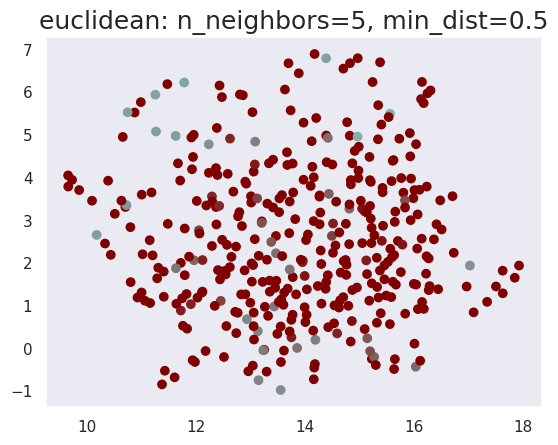

In [36]:
k = 5
min_dist = 0.5
umap_metric = 'euclidean'
visualize_embedding_umap(emb3, colors=emb_color3, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

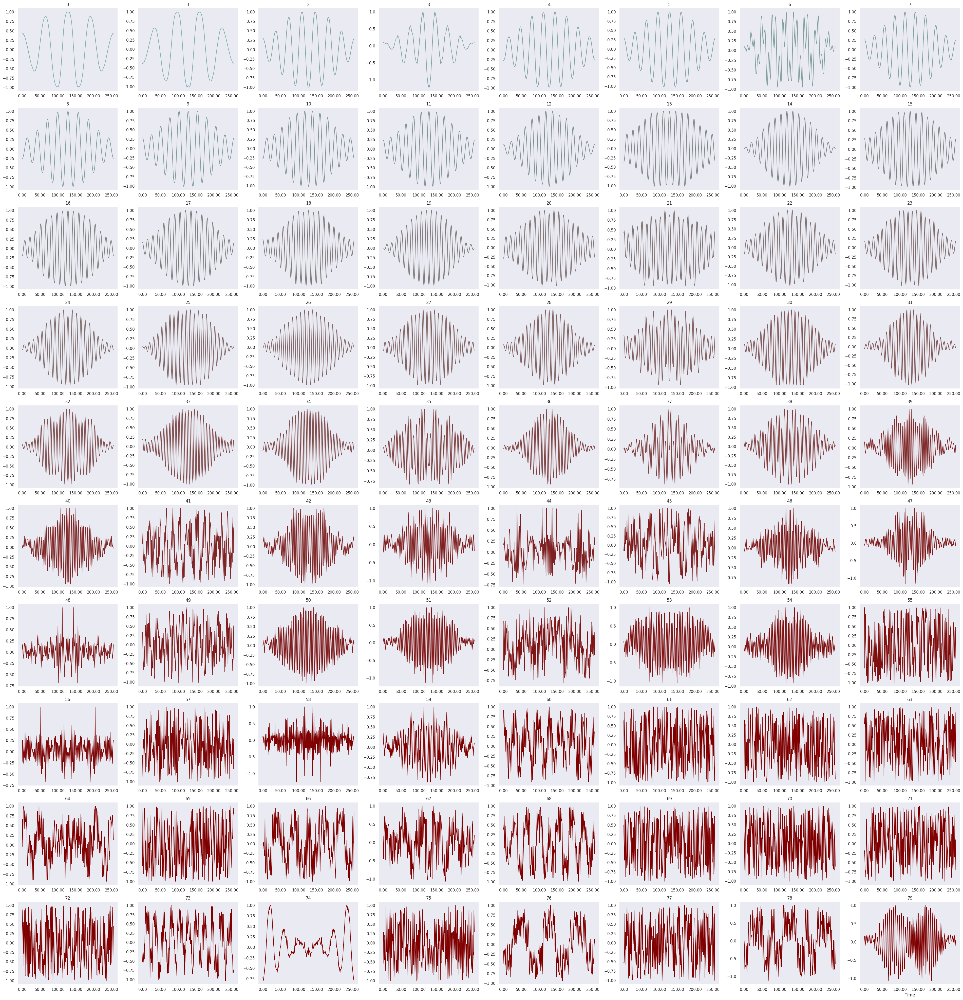

In [40]:
selected_emb_topk = torch.topk(zcs3, 80)
selected_idx = selected_emb_topk.indices
visualize_speech_codebook(
    emb3[selected_idx].numpy(), 
    n=80, colors=emb_color3[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

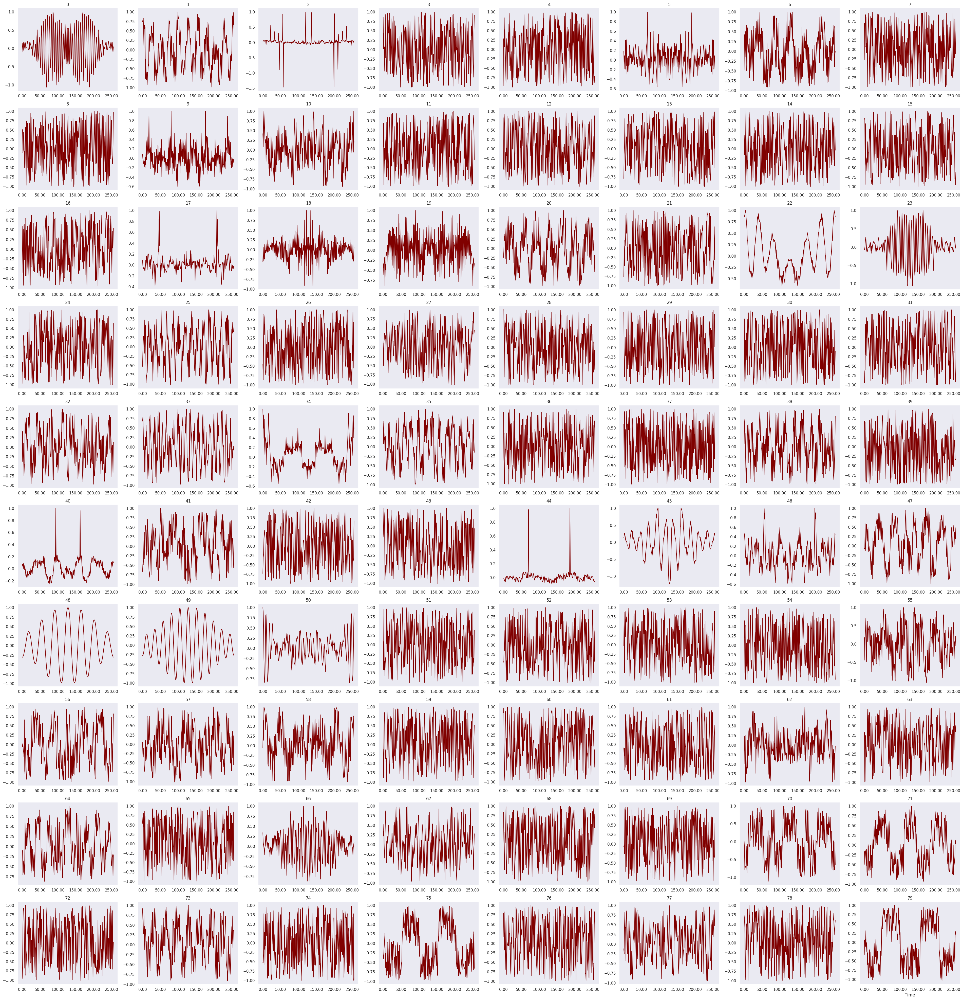

In [41]:
selected_emb_topk = torch.topk(zcs3, 160)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb3[selected_idx].numpy(), 
    n=80, colors=emb_color3[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

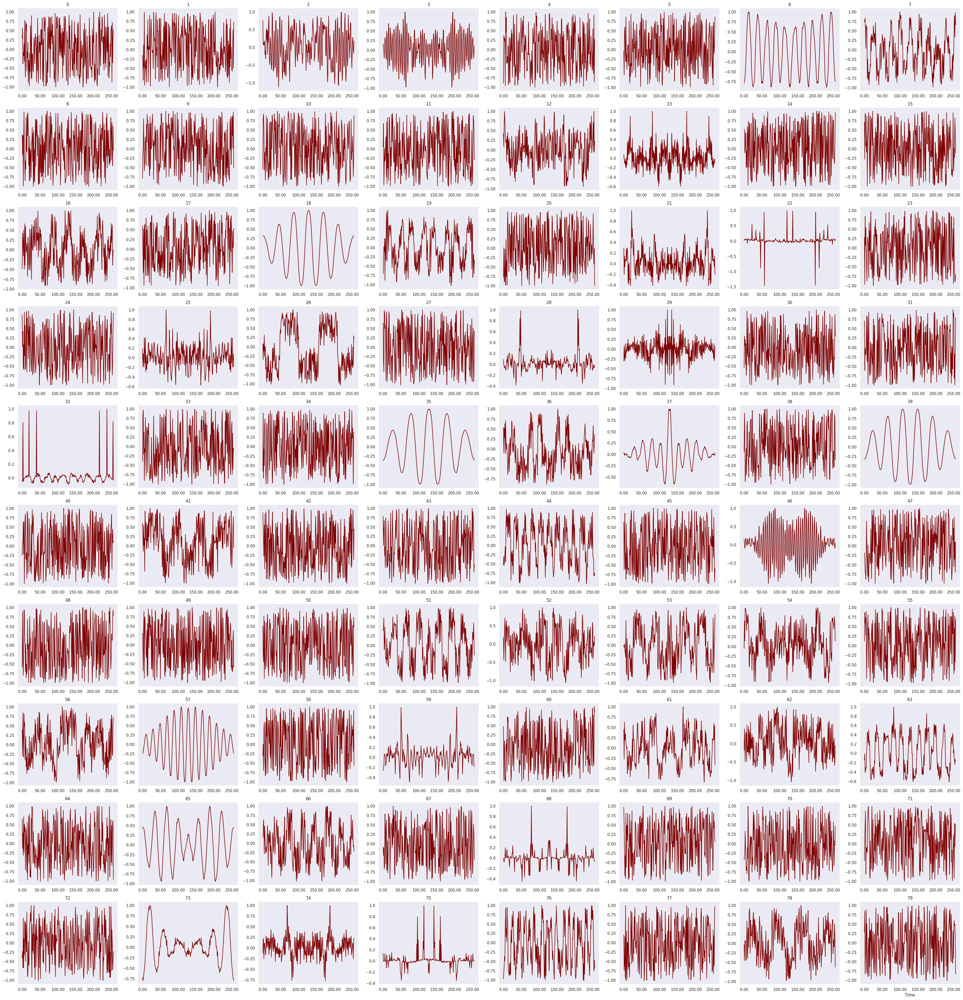

In [42]:
selected_emb_topk = torch.topk(zcs3, 240)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb3[selected_idx].numpy(), 
    n=80, colors=emb_color3[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

In [43]:
emb3_mfcc = model3.audio_encoder.vq.mfcc_embedding.embedding.weight.data.cpu()

In [45]:
emb_color3_mfcc, zcs3_mfcc = get_embedding_color_v2(emb3_mfcc)

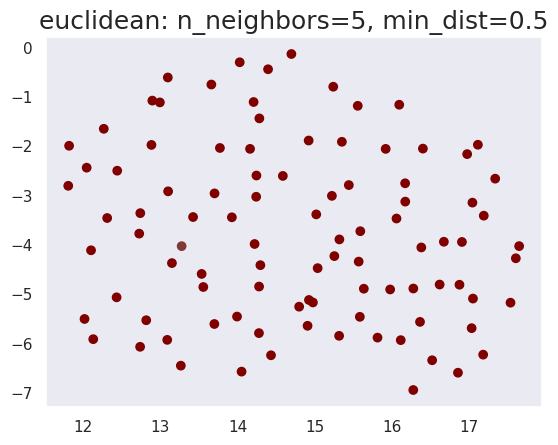

In [46]:
k = 5
min_dist = 0.5
umap_metric = 'euclidean'
visualize_embedding_umap(emb3_mfcc, colors=emb_color3_mfcc, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

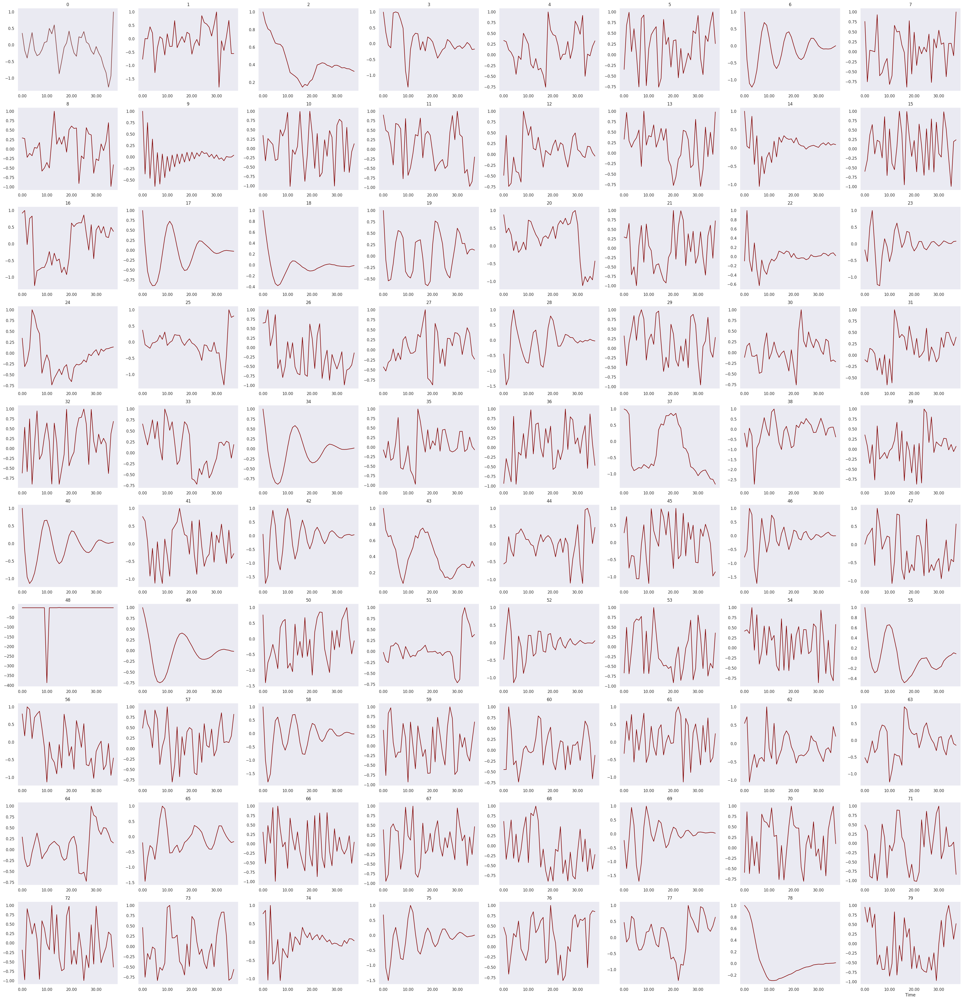

In [47]:
selected_emb_topk = torch.topk(zcs3_mfcc, 80)
selected_idx = selected_emb_topk.indices
visualize_speech_codebook(
    emb3_mfcc[selected_idx].numpy(), 
    n=80, colors=emb_color3_mfcc[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

In [49]:
emb_nomask = model_nomask.audio_encoder.vq.wave_embedding.embedding.weight.data.cpu()
emb_color_nomask, zcs_nomask = get_embedding_color_v2(emb_nomask)

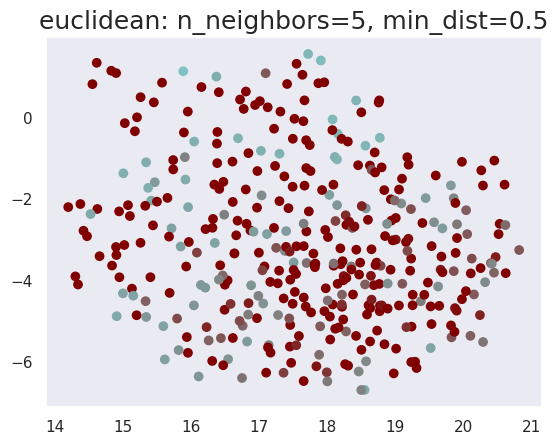

In [50]:
k = 5
min_dist = 0.5
umap_metric = 'euclidean'
visualize_embedding_umap(emb_nomask, colors=emb_color_nomask, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

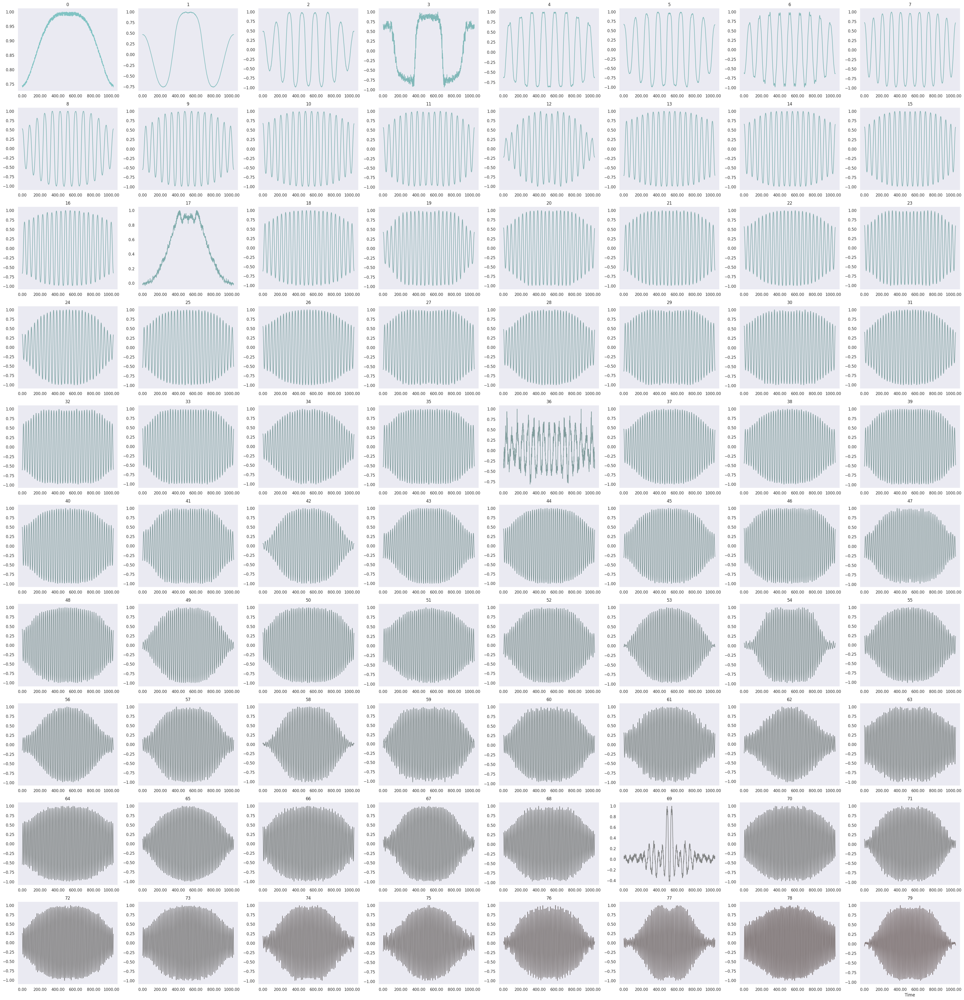

In [52]:
selected_emb_topk = torch.topk(zcs_nomask, 80)
selected_idx = selected_emb_topk.indices
visualize_speech_codebook(
    emb_nomask[selected_idx].numpy(), 
    n=80, colors=emb_color_nomask[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

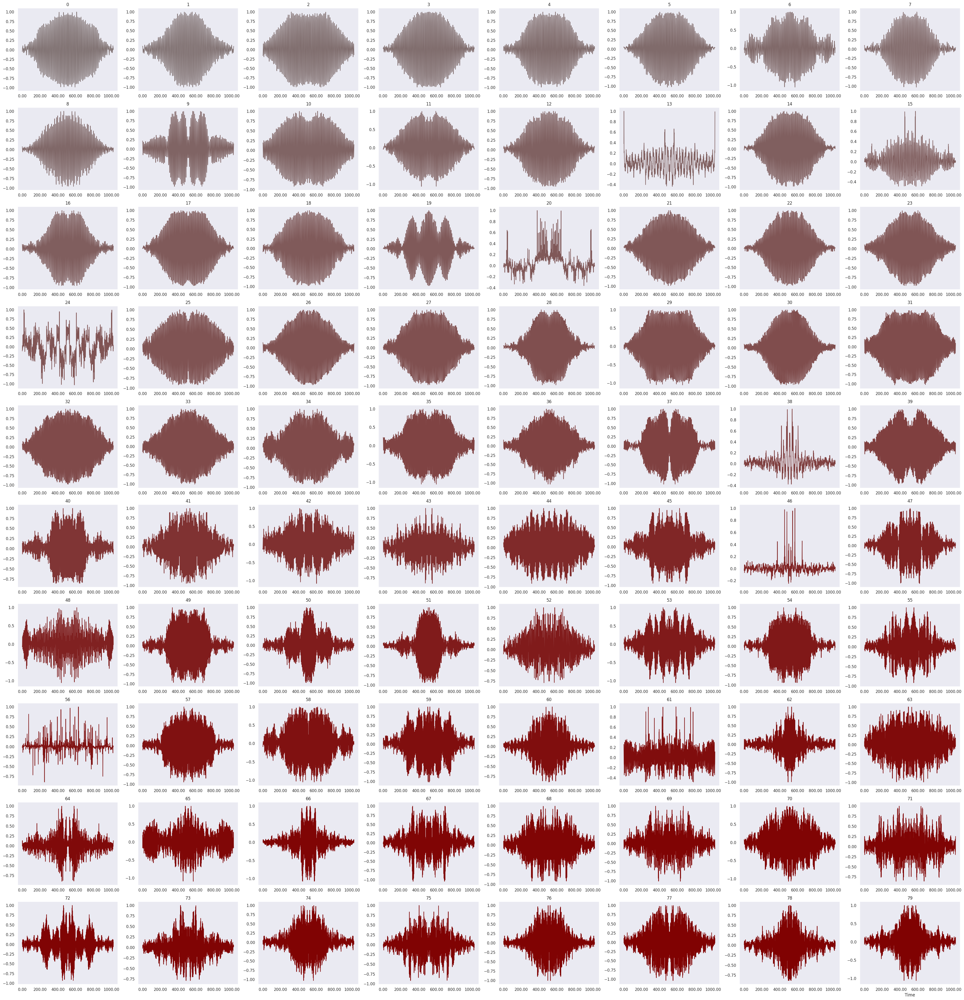

In [54]:
selected_emb_topk = torch.topk(zcs_nomask, 160)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb_nomask[selected_idx].numpy(), 
    n=80, colors=emb_color_nomask[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

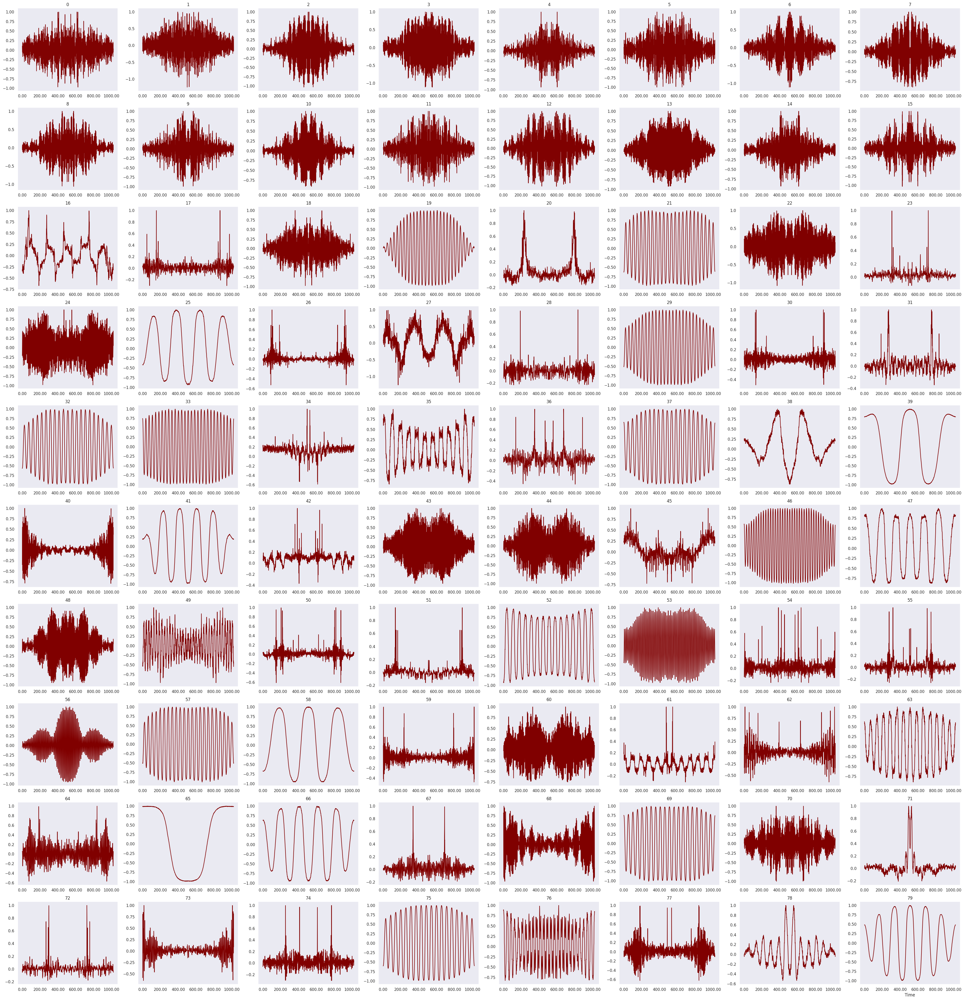

In [55]:
selected_emb_topk = torch.topk(zcs_nomask, 240)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb_nomask[selected_idx].numpy(), 
    n=80, colors=emb_color_nomask[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

In [56]:
emb_nomask_mfcc = model_nomask.audio_encoder.vq.mfcc_embedding.embedding.weight.data.cpu()
emb_color_nomask_mfcc, zcs_nomask = get_embedding_color_v2(emb_nomask_mfcc)

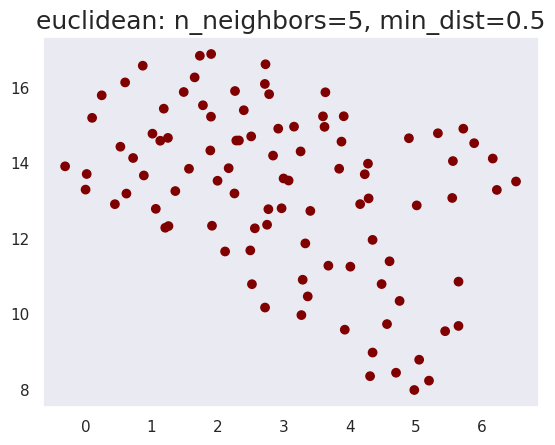

In [57]:
k = 5
min_dist = 0.5
umap_metric = 'euclidean'
visualize_embedding_umap(emb_nomask_mfcc, colors=emb_color_nomask_mfcc, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

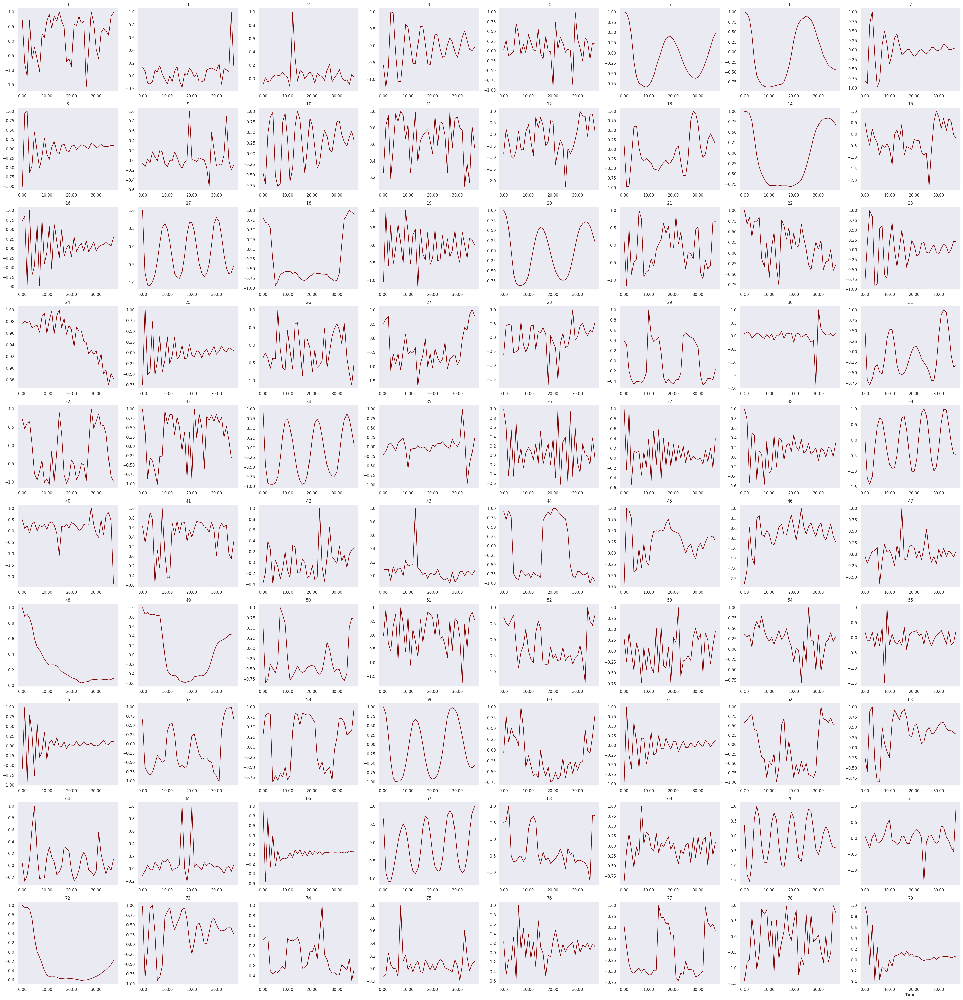

In [59]:
selected_emb_topk = torch.topk(zcs_nomask, 80)
selected_idx = selected_emb_topk.indices
visualize_speech_codebook(
    emb_nomask_mfcc[selected_idx].numpy(), 
    n=80, colors=emb_color_nomask_mfcc[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

In [65]:
emb = model.audio_encoder.vq.wave_embedding.embedding.weight.data.cpu()
emb_color, zcs = get_embedding_color_v2(emb)

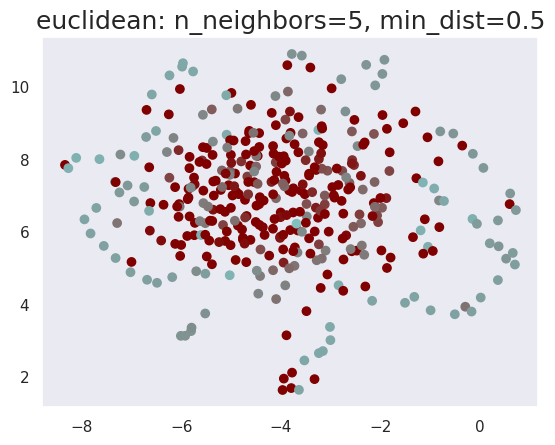

In [66]:
k = 5
min_dist = 0.5
umap_metric = 'euclidean'
visualize_embedding_umap(emb, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

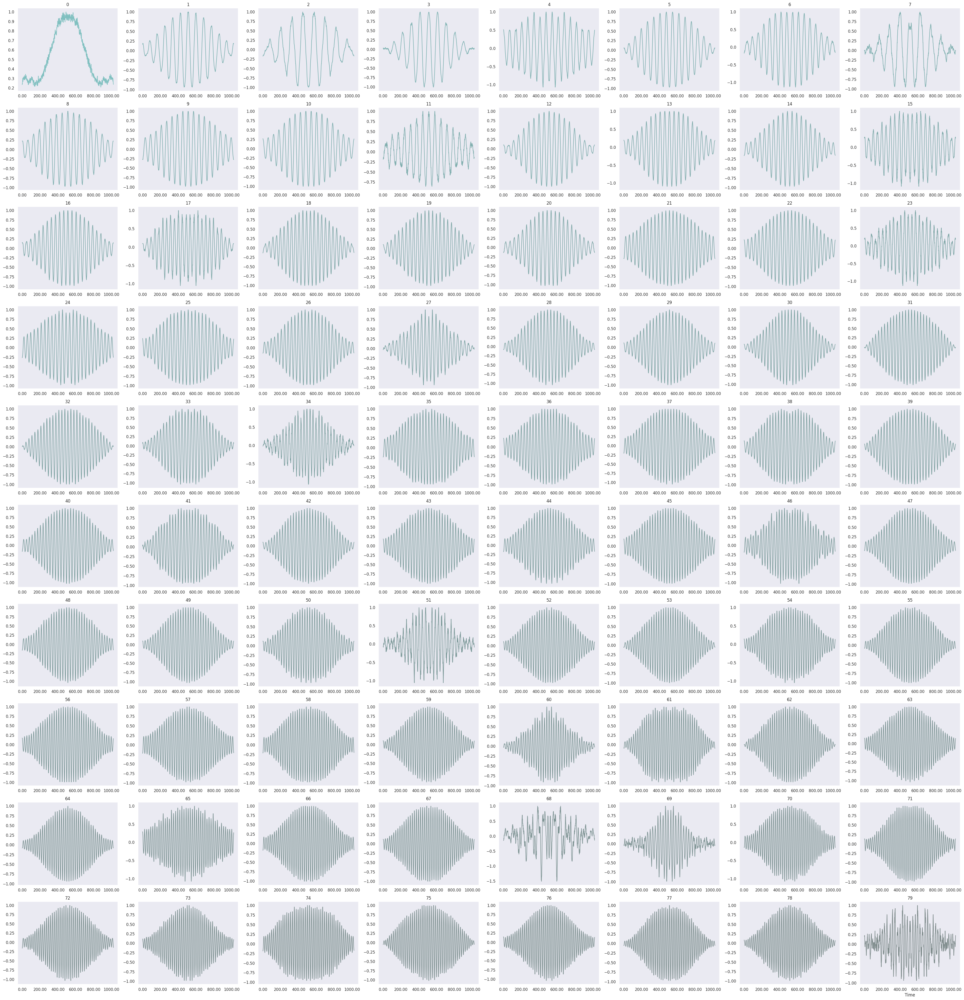

In [67]:
selected_emb_topk = torch.topk(zcs, 80)
selected_idx = selected_emb_topk.indices
visualize_speech_codebook(
    emb[selected_idx].numpy(), 
    n=80, colors=emb_color[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

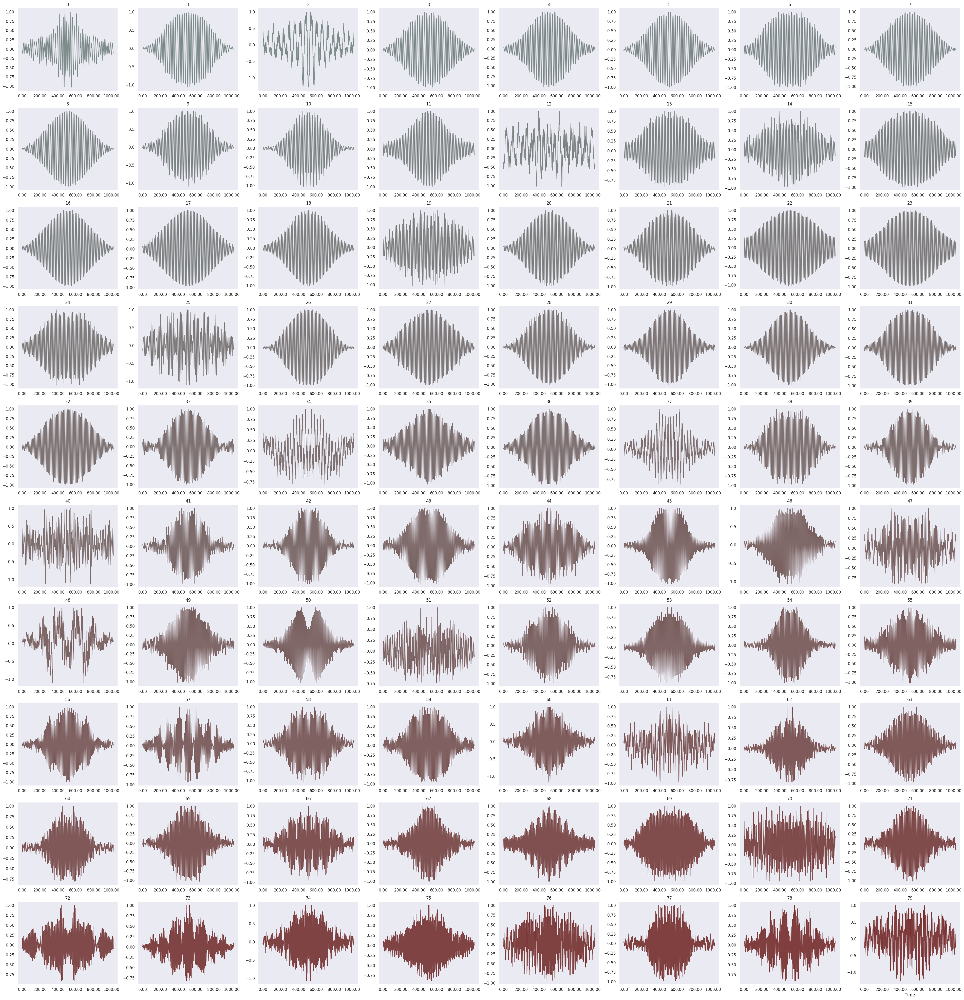

In [68]:
selected_emb_topk = torch.topk(zcs, 160)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb[selected_idx].numpy(), 
    n=80, colors=emb_color[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

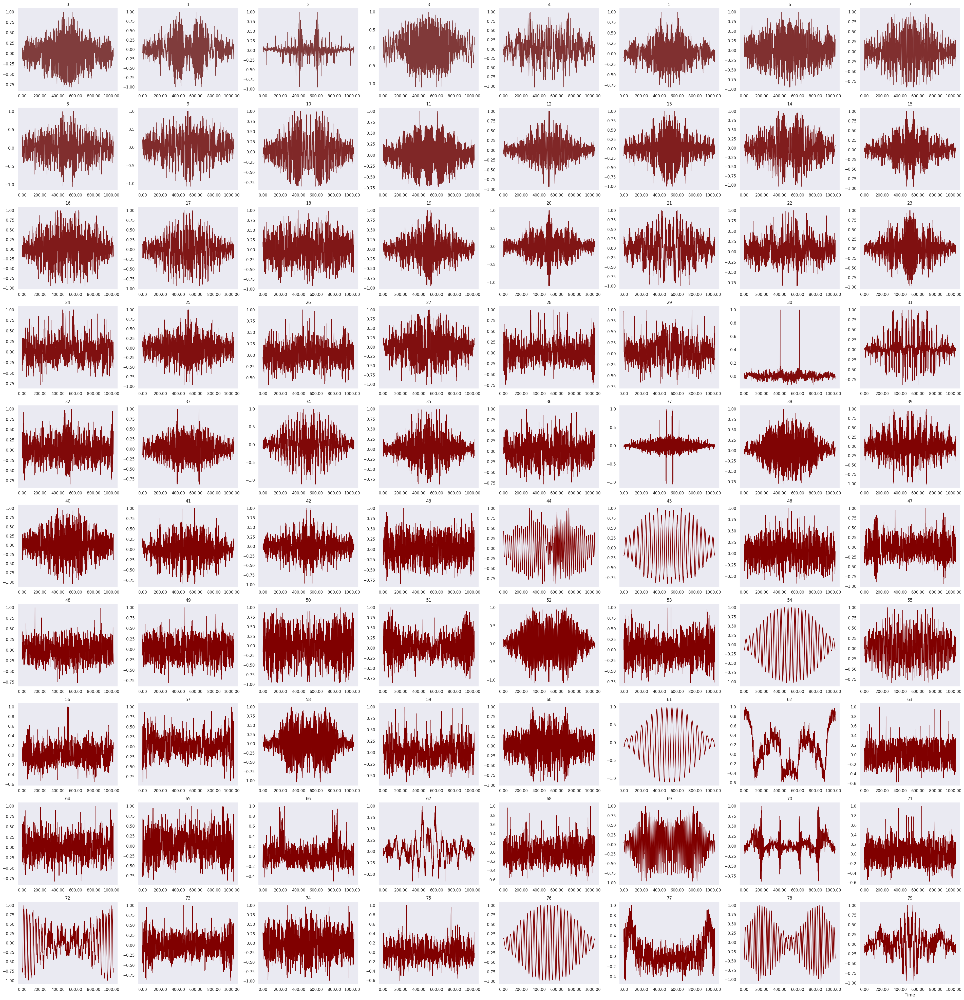

In [69]:
selected_emb_topk = torch.topk(zcs, 240)
selected_idx = selected_emb_topk.indices[-80:]
visualize_speech_codebook(
    emb[selected_idx].numpy(), 
    n=80, colors=emb_color[selected_idx], 
    feature_mel=False, waveplot_librosa=False)

In [70]:
emb_mfcc= model.audio_encoder.vq.mfcc_embedding.embedding.weight.data.cpu()
emb_color_mfcc, zcs_mfcc = get_embedding_color_v2(emb_mfcc)

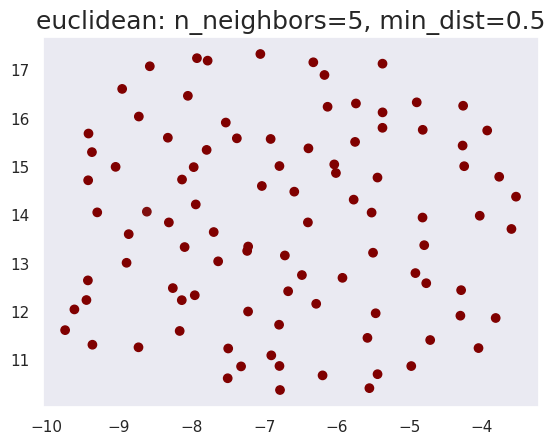

In [71]:
k = 5
min_dist = 0.5
umap_metric = 'euclidean'
visualize_embedding_umap(emb_mfcc, colors=emb_color_mfcc, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric=umap_metric, 
          title=f'{umap_metric}: n_neighbors={k}, min_dist={min_dist}')

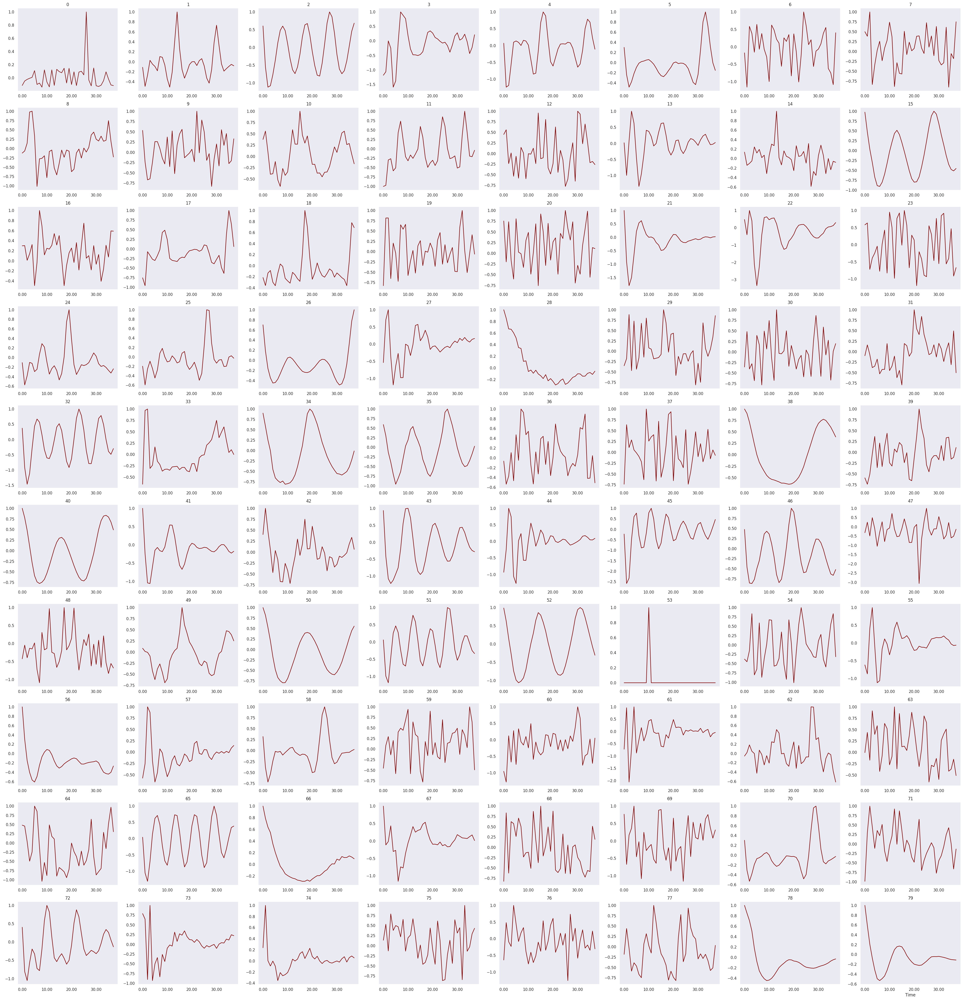

In [72]:
selected_emb_topk = torch.topk(zcs_mfcc, 80)
selected_idx = selected_emb_topk.indices
visualize_speech_codebook(
    emb_mfcc[selected_idx].numpy(), 
    n=80, colors=emb_color_mfcc[selected_idx], 
    feature_mel=False, waveplot_librosa=False)